In [45]:
# Import required libraries

# pandas - For data manipulation and analysis of tabular data (landmarks and protocol files)
import pandas as pd

# numpy - For numerical operations and array manipulation of pupil measurements
import numpy as np

# matplotlib - For creating static visualizations of pupil response data
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import to_rgba

# pathlib - For cross-platform file path handling
from pathlib import Path

# logging - For tracking program execution and debugging information
import logging

# scipy.signal - For signal processing operations like Savitzky-Golay filtering
from scipy import signal

# seaborn - For enhanced statistical data visualization built on matplotlib
import seaborn as sns

# shapely.geometry - For polygon area calculation
from shapely.geometry import Polygon
from scipy.interpolate import CubicSpline # Add this import

# Configure logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s'
)
logger = logging.getLogger(__name__)

In [46]:
def load_validate_file(file_path):
    """
    Load and validate landmarks data file
    
    Args:
        file_path (str): Path to landmarks CSV file
        
    Returns:
        pd.DataFrame: Processed landmarks data
    """
    try:
        df = pd.read_csv(file_path)
        
        # Required columns for timestamp and status
        base_columns = ['timestamp', 'id', 'retcode']
        
        # Generate expected landmark column names for both eyes
        landmark_columns = []
        for eye in ['left', 'right']:
            for i in range(1, 28):  # 27 landmarks per eye
                landmark_columns.extend([
                    f'{eye}_lm_{i}_x',
                    f'{eye}_lm_{i}_y'
                ])
        
        required_columns = base_columns + landmark_columns
        
        # Verify all required columns exist
        missing_columns = [col for col in required_columns if col not in df.columns]
        if missing_columns:
            raise ValueError(f"Missing required columns: {', '.join(missing_columns)}")
            
        logger.info(f"Successfully validated landmarks file {file_path.name} with {len(df)} rows")
        return df
    except Exception as e:
        logger.error(f"Error loading landmarks file: {e}")
        raise

data_path = Path().cwd().parent / "data"
# for subfolder in data_path.iterdir():
#     if subfolder.is_dir():
#         # landmarks_file = subfolder / f'{subfolder.name}_plr_landmarks.csv'
#         # protocol_file = subfolder / f'{subfolder.name}_plr_protocol.csv'
        
#         # Load landmarks and protocol files
#         landmarks_df = load_validate_file(landmarks_file)
#         # protocol_df = load_protocol_file(protocol_file)

# Find the landmarks.csv file
landmarks_file = list(data_path.glob('**/*landmarks.csv'))

first_plr_file = landmarks_file[4]

# Load landmarks data into DataFrame
landmarks_df = pd.read_csv(first_plr_file)

# Display first few rows
landmarks_df.head()  # Added .head() to display first few rows

,Unnamed: 0,timestamp,id,retcode,left_lm_1_x,left_lm_1_y,left_lm_2_x,left_lm_2_y,left_lm_3_x,left_lm_3_y,...,right_lm_23_x,right_lm_23_y,right_lm_24_x,right_lm_24_y,right_lm_25_x,right_lm_25_y,right_lm_26_x,right_lm_26_y,right_lm_27_x,right_lm_27_y
0,0,2024-11-19 10:24:26.679,1802,OK,189.0,913.8,247.5,866.5,285.8,863.3,...,774.3,868.3,756.0,868.8,756.5,879.0,831.3,862.0,868.0,884.0
1,1,2024-11-19 10:24:26.714,1803,OK,189.0,912.0,247.8,867.5,285.5,864.5,...,786.0,875.5,768.5,876.0,768.5,885.8,848.8,870.3,886.0,889.5
2,2,2024-11-19 10:24:26.745,1804,OK,190.0,913.3,248.0,866.8,286.8,863.5,...,783.5,869.8,761.5,870.3,761.5,882.3,841.5,867.3,876.5,888.0
3,3,2024-11-19 10:24:26.772,1805,OK,191.0,914.3,248.8,869.3,287.5,865.5,...,782.8,868.5,764.0,869.0,764.3,879.0,837.5,863.3,874.8,884.0
4,4,2024-11-19 10:24:26.804,1806,OK,190.0,914.8,249.3,869.3,288.0,866.5,...,775.0,878.5,752.5,878.8,752.8,889.8,833.5,875.3,871.0,895.3


In [47]:
def filter_ok_landmarks_data(df):
    """
    Clean landmarks data by removing invalid frames
    
    Args:
        df (pd.DataFrame): Raw landmarks data
        
    Returns:
        pd.DataFrame: Cleaned landmarks data
    """
    # Remove frames with invalid retCode
    cleaned_df = df[df['retcode'] == 'OK'].copy()
    
    # Reset index after filtering
    cleaned_df.reset_index(drop=True, inplace=True)
    
    logger.info(f"Removed {len(df) - len(cleaned_df)} frames with invalid retCode")
    return cleaned_df

landmarks_df_cleaned = filter_ok_landmarks_data(landmarks_df)

2025-04-16 19:02:45,542 - INFO - Removed 61 frames with invalid retCode


In [48]:
numerical_cols = landmarks_df_cleaned.select_dtypes(include=['float64', 'int64']).columns.tolist()
exclude_cols = ['Unnamed: 0', 'id']
landmark_cols = [col for col in numerical_cols if col not in exclude_cols]
landmark_cols[:5]

['left_lm_1_x', 'left_lm_1_y', 'left_lm_2_x', 'left_lm_2_y', 'left_lm_3_x']

In [49]:
# Drop rows with index 30 to 42
landmarks_df_cleaned.drop(landmarks_df_cleaned.index[30:43], inplace=True)

# Reset index after dropping rows
landmarks_df_cleaned.reset_index(drop=True, inplace=True)

# Display the shape of the dataframe after dropping rows
print(f"Shape after dropping rows 30-42: {landmarks_df_cleaned.shape}")

Shape after dropping rows 30-42: (197, 112)


# Pupil Size Extraction

In [50]:
def get_pupil_boundary_points(frame, eye):
    """Extract pupil boundary points for a specific eye and frame"""
    boundary_points = []
    for lm in [7, 25, 9, 22, 10, 23, 24]:  # Pupil landmarks (not closing the loop with 7 again)
        x = frame[f'{eye}_lm_{lm}_x'].iloc[0]
        y = frame[f'{eye}_lm_{lm}_y'].iloc[0]
        boundary_points.append((x, y))
    return boundary_points

def get_pupil_center(frame, eye):
    """Get the center point (landmark 8) of the pupil"""
    center_x = frame[f'{eye}_lm_8_x'].iloc[0]
    center_y = frame[f'{eye}_lm_8_y'].iloc[0]
    return center_x, center_y

def cartesian_to_polar(center, boundary_points):
    """Convert Cartesian boundary points to polar coordinates relative to the center."""
    points_polar = []
    for p in boundary_points:
        dx = p[0] - center[0]
        dy = p[1] - center[1]
        angle = np.arctan2(dy, dx)
        distance = np.sqrt(dx**2 + dy**2)
        points_polar.append((angle, distance))
    return points_polar

def sort_polar_points(points_polar):
    """Sort polar points by angle."""
    points_polar.sort(key=lambda pp: pp[0])
    angles = [pp[0] for pp in points_polar]
    distances = [pp[1] for pp in points_polar]
    return angles, distances

def prepare_spline_data(angles, distances):
    """Prepare angles and distances for spline interpolation."""
    wrapped_angles = angles.copy()
    wrapped_distances = distances.copy()

    # Handle edge case for wrapping if points don't cover a full circle
    if not wrapped_angles or max(wrapped_angles) - min(wrapped_angles) < 1.9 * np.pi:
        if wrapped_angles: # Ensure list is not empty before accessing index 0
             wrapped_angles.append(wrapped_angles[0] + 2 * np.pi)
             wrapped_distances.append(wrapped_distances[0])
        else:
            # Handle empty input if necessary, maybe return empty lists or raise error
            return [], []

    # Ensure strictly increasing sequence for angles
    eps = 1e-10
    for i in range(1, len(wrapped_angles)):
        if wrapped_angles[i] <= wrapped_angles[i-1]:
            wrapped_angles[i] = wrapped_angles[i-1] + eps

    return wrapped_angles, wrapped_distances


def create_spline_interpolator(angles, distances):
    """Create a cubic spline interpolator using periodic boundary conditions."""
    if not angles or not distances: # Handle empty lists
        logger.warning("create_spline_interpolator received empty angles or distances.")
        return None # Or raise an error
    # Ensure the input data is suitable for periodic spline (last angle = first angle + 2*pi)
    # This is handled in prepare_spline_data
    if not np.isclose(angles[-1], angles[0] + 2 * np.pi):
         logger.warning("Input angles may not be properly wrapped for periodic spline.")
    # Use 'periodic' boundary condition
    return CubicSpline(angles, distances, bc_type='periodic')

def generate_interpolated_polar_points(cs, start_angle, num_points=50):
    """Generate smooth interpolated points in polar coordinates."""
    if cs is None:
        return [], []
    interp_angles = np.linspace(start_angle, start_angle + 2*np.pi, num_points, endpoint=False)
    interp_distances = cs(interp_angles)
    return interp_angles, interp_distances

def polar_to_cartesian(center, angles, distances):
    """Convert polar coordinates back to Cartesian coordinates."""
    interp_points = []
    for angle, dist in zip(angles, distances):
        # Normalize angle to be within [0, 2*pi) if needed, though linspace should handle it
        norm_angle = angle % (2 * np.pi)
        x = center[0] + dist * np.cos(norm_angle)
        y = center[1] + dist * np.sin(norm_angle)
        interp_points.append((x, y))
    return interp_points

def interpolate_pupil(center, boundary_points, num_points=36):
    """Create a smooth interpolated pupil boundary using cubic spline."""
    if not boundary_points:
        logger.warning("interpolate_pupil received empty boundary_points.")
        return [] # Return empty list if no boundary points

    # 1. Convert to polar coordinates
    points_polar = cartesian_to_polar(center, boundary_points)

    # 2. Sort by angle
    angles, distances = sort_polar_points(points_polar)

    # 3. Prepare data for spline (wrapping, ensure increasing angles)
    spline_angles, spline_distances = prepare_spline_data(angles, distances)

    # Handle case where preparation might fail (e.g., empty input)
    if not spline_angles:
        logger.warning("Could not prepare spline data, possibly due to insufficient input points.")
        return []

    # 4. Create spline interpolator
    cs = create_spline_interpolator(spline_angles, spline_distances)
    if cs is None:
        logger.warning("Failed to create spline interpolator.")
        return []


    # 5. Generate interpolated points in polar coordinates
    start_angle = min(spline_angles) # Use the minimum angle from the prepared data
    interp_angles, interp_distances = generate_interpolated_polar_points(cs, start_angle, num_points)

    # 6. Convert back to Cartesian coordinates
    interp_points = polar_to_cartesian(center, interp_angles, interp_distances)

    return interp_points

In [51]:

frame = landmarks_df_cleaned.iloc[[2]]

eye = 'right'

center_x, center_y = get_pupil_center(frame, eye)
center = (center_x, center_y)

boundary_points = get_pupil_boundary_points(frame, eye)

interpolated_pupil_points = interpolate_pupil(center, boundary_points, num_points=50)
interpolated_pupil_points_polygon = Polygon(interpolated_pupil_points)

# Calculate the area of the polygon
area = interpolated_pupil_points_polygon.area

area

476.1264891597315

In [52]:
non_interpolated_pupil_points = boundary_points + [boundary_points[0]]  # Close the loop by adding the first point at the end
non_interpolated_pupil_points_polygon = Polygon(non_interpolated_pupil_points)

non_interpolated_area = non_interpolated_pupil_points_polygon.area
non_interpolated_area

352.6250000000003

### Now we run this logic into all of the frames of a test

In [53]:
# Assuming all necessary functions (get_pupil_center, get_pupil_boundary_points, interpolate_pupil, etc.)
# and landmarks_df_cleaned are defined above this cell.
# Also assuming logger is configured.

# Dictionary to store results for both eyes
eye_data = {
    'right': {
        'results_list': [],
        'interpolated_points_dict': {}
    },
    'left': {
        'results_list': [],
        'interpolated_points_dict': {}
    }
}

# Process both eyes
for eye in ['right', 'left']:
    # Iterate through each row (frame) of the cleaned DataFrame
    for index, frame_row in landmarks_df_cleaned.iterrows():
        # Create a DataFrame containing only the current row
        frame_df = landmarks_df_cleaned.iloc[[index]]
        timestamp = frame_row['timestamp']  # Get timestamp for storage

        try:
            # 1. Get Center
            center_x, center_y = get_pupil_center(frame_df, eye)
            center = (center_x, center_y)

            # 2. Get Boundary Points
            boundary_points = get_pupil_boundary_points(frame_df, eye)

            # 3. Interpolate Pupil
            interpolated_pupil_points = interpolate_pupil(center, boundary_points, num_points=50)

            # 4. Calculate Interpolated Area
            # Check if interpolation returned enough points to form a polygon
            if len(interpolated_pupil_points) >= 3:
                 interpolated_polygon = Polygon(interpolated_pupil_points)
                 interpolated_area = interpolated_polygon.area
            else:
                 interpolated_area = np.nan # Not enough points for a polygon
                 logger.warning(f"Not enough interpolated points ({len(interpolated_pupil_points)}) to form polygon for {eye} eye, frame index {index}.")


            # 5. Calculate Non-Interpolated Area
            # Check if boundary points exist and form a valid polygon
            if len(boundary_points) >= 3:
                non_interpolated_polygon_points = boundary_points + [boundary_points[0]]
                non_interpolated_polygon = Polygon(non_interpolated_polygon_points)
                non_interpolated_area = non_interpolated_polygon.area
            else:
                non_interpolated_area = np.nan # Not enough points for a polygon
                logger.warning(f"Not enough boundary points ({len(boundary_points)}) to form polygon for {eye} eye, frame index {index}.")


            # 6. Store scalar results in list for this eye
            eye_data[eye]['results_list'].append({
                'frame_index': index,  # Store index for merging
                'timestamp': timestamp,
                f'{eye}_interpolated_area': interpolated_area,
                f'{eye}_non_interpolated_area': non_interpolated_area,
            })

            # 7. Store interpolated points in dictionary (keyed by index) for this eye
            # Only store if interpolation was successful
            if not np.isnan(interpolated_area):
                 eye_data[eye]['interpolated_points_dict'][index] = interpolated_pupil_points
            # else: # Optionally handle the case where points are not stored
            #    eye_data[eye]['interpolated_points_dict'][index] = [] # Store empty list


        except Exception as e:
            logger.error(f"Error processing {eye} eye for frame index {index} (Timestamp: {timestamp}): {e}")
            # Store NaN entry in case of unexpected error
            eye_data[eye]['results_list'].append({
                'frame_index': index,
                'timestamp': timestamp,
                f'{eye}_interpolated_area': np.nan,
                f'{eye}_non_interpolated_area': np.nan,
            })
            # Optionally handle storing points on error
            # eye_data[eye]['interpolated_points_dict'][index] = [] # Store empty list

# --- After the loop ---
# Create DataFrames from the collected results
right_results_df = pd.DataFrame(eye_data['right']['results_list'])
left_results_df = pd.DataFrame(eye_data['left']['results_list'])

# Set index for merging
right_results_df.set_index('frame_index', inplace=True)
left_results_df.set_index('frame_index', inplace=True)

# Combine both eye results
combined_results_df = right_results_df.merge(
    left_results_df[['left_interpolated_area', 'left_non_interpolated_area']],
    left_index=True,
    right_index=True,
    how='outer'  # Use outer to keep all frames from both eyes
)

# --- MODIFIED MERGE ---
# Select only the new area columns from combined_results_df to avoid merging duplicate 'timestamp'
area_columns_to_merge = [
    'right_interpolated_area', 'right_non_interpolated_area',
    'left_interpolated_area', 'left_non_interpolated_area'
]
# Ensure combined_results_df has the expected columns before selecting
available_cols = [col for col in area_columns_to_merge if col in combined_results_df.columns]

landmarks_df_calculated = landmarks_df_cleaned.merge(
    combined_results_df[available_cols], # Select only the available area columns
    left_index=True,
    right_index=True,
    how='left'  # Keep all rows from landmarks_df_cleaned
)
# --- END MODIFIED MERGE ---


# Store interpolated points dictionaries for later access
right_interpolated_points_dict = eye_data['right']['interpolated_points_dict']
left_interpolated_points_dict = eye_data['left']['interpolated_points_dict']

# Display the updated DataFrame head
print("Updated landmarks_df_calculated with area columns for both eyes:")
# Check if 'timestamp' column exists before printing
if 'timestamp' in landmarks_df_calculated.columns:
    print(landmarks_df_calculated[['timestamp',
                                  'right_interpolated_area', 'right_non_interpolated_area',
                                  'left_interpolated_area', 'left_non_interpolated_area']].head())
else:
    print("Error: 'timestamp' column not found in landmarks_df_calculated after merge.")
    print("Columns available:", landmarks_df_calculated.columns)
    print(landmarks_df_calculated.head()) # Print head anyway to see available columns


# Display sample points from both eyes
print("\nSample of right_interpolated_points_dict:")
for i, key in enumerate(right_interpolated_points_dict.keys()):
    if i >= 2: break  # Show first 2 entries
    print(f"Frame Index {key}: {len(right_interpolated_points_dict[key])} points")

print("\nSample of left_interpolated_points_dict:")
for i, key in enumerate(left_interpolated_points_dict.keys()):
    if i >= 2: break  # Show first 2 entries
    print(f"Frame Index {key}: {len(left_interpolated_points_dict[key])} points")


Updated landmarks_df_calculated with area columns for both eyes:
                 timestamp  right_interpolated_area  \
0  2024-11-19 10:24:26.679               333.550087   
1  2024-11-19 10:24:26.714               314.698306   
2  2024-11-19 10:24:26.745               476.126489   
3  2024-11-19 10:24:26.772               342.949493   
4  2024-11-19 10:24:26.804               454.125181   

   right_non_interpolated_area  left_interpolated_area  \
0                      242.275             1537.061208   
1                      235.120             1362.523648   
2                      352.625             1424.446174   
3                      249.625             1449.512261   
4                      326.095             1516.894946   

   left_non_interpolated_area  
0                    1132.675  
1                     988.320  
2                    1047.670  
3                    1057.100  
4                    1095.820  

Sample of right_interpolated_points_dict:
Frame Index 0: 50 po

In [54]:
landmarks_df_calculated.head()

,Unnamed: 0,timestamp,id,retcode,left_lm_1_x,left_lm_1_y,left_lm_2_x,left_lm_2_y,left_lm_3_x,left_lm_3_y,...,right_lm_25_x,right_lm_25_y,right_lm_26_x,right_lm_26_y,right_lm_27_x,right_lm_27_y,right_interpolated_area,right_non_interpolated_area,left_interpolated_area,left_non_interpolated_area
0,0,2024-11-19 10:24:26.679,1802,OK,189.0,913.8,247.5,866.5,285.8,863.3,...,756.5,879.0,831.3,862.0,868.0,884.0,333.550087,242.275,1537.061208,1132.675
1,1,2024-11-19 10:24:26.714,1803,OK,189.0,912.0,247.8,867.5,285.5,864.5,...,768.5,885.8,848.8,870.3,886.0,889.5,314.698306,235.120,1362.523648,988.320
2,2,2024-11-19 10:24:26.745,1804,OK,190.0,913.3,248.0,866.8,286.8,863.5,...,761.5,882.3,841.5,867.3,876.5,888.0,476.126489,352.625,1424.446174,1047.670
3,3,2024-11-19 10:24:26.772,1805,OK,191.0,914.3,248.8,869.3,287.5,865.5,...,764.3,879.0,837.5,863.3,874.8,884.0,342.949493,249.625,1449.512261,1057.100
4,4,2024-11-19 10:24:26.804,1806,OK,190.0,914.8,249.3,869.3,288.0,866.5,...,752.8,889.8,833.5,875.3,871.0,895.3,454.125181,326.095,1516.894946,1095.820


Plotting 197 frames containing data for at least one eye


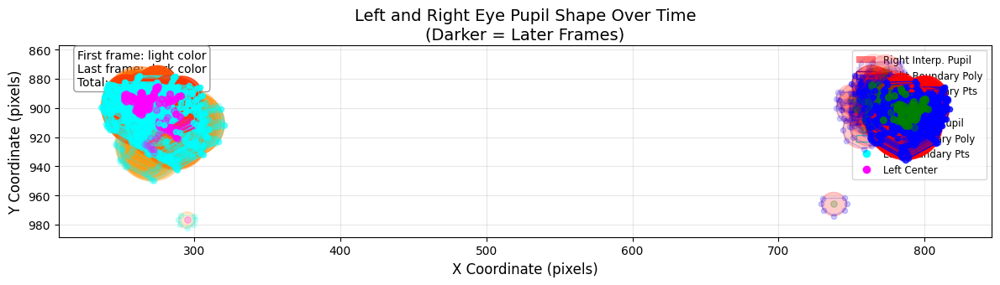

In [55]:
# Create a new figure with appropriate size
plt.figure(figsize=(12, 8)) # Increased size slightly

# --- Define colors for each eye ---
colors = {
    'right': {'interp': 'red', 'boundary': 'blue', 'center': 'green'},
    'left': {'interp': 'orange', 'boundary': 'cyan', 'center': 'magenta'}
}

# --- Find all unique valid frame indices across both eyes ---
all_indices = set(right_interpolated_points_dict.keys()) | set(left_interpolated_points_dict.keys())
valid_indices = sorted([
    idx for idx in all_indices
    if (idx in right_interpolated_points_dict and not np.isnan(landmarks_df_calculated.loc[idx, 'right_interpolated_area'])) or \
       (idx in left_interpolated_points_dict and not np.isnan(landmarks_df_calculated.loc[idx, 'left_interpolated_area']))
])

# Total number of valid frames for color gradient calculation
num_frames = len(valid_indices)
if num_frames == 0:
    print("No valid frames to plot for either eye")
else:
    print(f"Plotting {num_frames} frames containing data for at least one eye")

    # --- Calculate combined axis limits ---
    all_x = []
    all_y = []
    for eye_dict in [right_interpolated_points_dict, left_interpolated_points_dict]:
        for idx in valid_indices:
            if idx in eye_dict:
                points = eye_dict[idx]
                if points: # Check if list is not empty
                    all_x.extend([p[0] for p in points])
                    all_y.extend([p[1] for p in points])

    if all_x and all_y:
        x_padding = (max(all_x) - min(all_x)) * 0.05 if max(all_x) != min(all_x) else 1
        y_padding = (max(all_y) - min(all_y)) * 0.05 if max(all_y) != min(all_y) else 1
        plt.xlim(min(all_x) - x_padding, max(all_x) + x_padding)
        plt.ylim(max(all_y) + y_padding, min(all_y) - y_padding) # Invert y-axis
    else:
        print("Warning: Could not determine plot limits.")

    # --- Plot each frame ---
    for i, idx in enumerate(valid_indices):
        # Calculate alpha/darkness based on frame position
        alpha = 0.1 + 0.7 * (i / (num_frames - 1)) if num_frames > 1 else 0.5
        darkness_factor = i / (num_frames - 1) if num_frames > 1 else 0.5

        # Get the full frame data once
        frame_df = landmarks_df_cleaned.iloc[[idx]]

        # --- Process and plot each eye ---
        for eye in ['right', 'left']:
            eye_dict = right_interpolated_points_dict if eye == 'right' else left_interpolated_points_dict
            area_col = f'{eye}_interpolated_area'

            # Check if data exists and is valid for this eye and frame
            if idx in eye_dict and not np.isnan(landmarks_df_calculated.loc[idx, area_col]):
                interp_points = eye_dict[idx]
                boundary_points = get_pupil_boundary_points(frame_df, eye)
                center_x, center_y = get_pupil_center(frame_df, eye)
                eye_colors = colors[eye]

                # --- Calculate frame-specific color ---
                base_color_rgba = to_rgba(eye_colors['interp'])
                frame_color = (base_color_rgba[0],
                               base_color_rgba[1] * (1 - 0.7 * darkness_factor),
                               base_color_rgba[2] * (1 - 0.7 * darkness_factor),
                               alpha) # Use calculated alpha

                # --- Plot Interpolated Polygon ---
                if len(interp_points) >= 3:
                    interp_poly = plt.Polygon(interp_points,
                                              color=frame_color, # Use frame-specific color
                                              fill=True,
                                              alpha=alpha, # Use calculated alpha
                                              zorder=10 + i) # Stacking order
                    plt.gca().add_patch(interp_poly)

                # --- Plot Boundary Polygon ---
                if len(boundary_points) >= 3:
                    boundary_poly_points = boundary_points + [boundary_points[0]]
                    boundary_poly = plt.Polygon(boundary_poly_points,
                                               fill=False,
                                               edgecolor=eye_colors['boundary'],
                                               linewidth=1,
                                               alpha=alpha, # Use calculated alpha
                                               zorder=50 + i)
                    plt.gca().add_patch(boundary_poly)

                # --- Plot Boundary Points ---
                if boundary_points:
                    x_points = [p[0] for p in boundary_points]
                    y_points = [p[1] for p in boundary_points]
                    plt.scatter(x_points, y_points, color=eye_colors['boundary'], s=20, alpha=alpha, zorder=100 + i)

                # --- Plot Center Point ---
                plt.scatter(center_x, center_y, color=eye_colors['center'], s=30, alpha=alpha, zorder=200 + i)


    # --- Add Legend ---
    legend_elements = [
        patches.Patch(facecolor=colors['right']['interp'], alpha=0.5, label='Right Interp. Pupil'),
        patches.Patch(facecolor='white', edgecolor=colors['right']['boundary'], label='Right Boundary Poly'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=colors['right']['boundary'], markersize=8, label='Right Boundary Pts'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=colors['right']['center'], markersize=8, label='Right Center'),
        # Left Eye Legend Elements
        patches.Patch(facecolor=colors['left']['interp'], alpha=0.5, label='Left Interp. Pupil'),
        patches.Patch(facecolor='white', edgecolor=colors['left']['boundary'], label='Left Boundary Poly'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=colors['left']['boundary'], markersize=8, label='Left Boundary Pts'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=colors['left']['center'], markersize=8, label='Left Center')
    ]
    plt.legend(handles=legend_elements, loc='upper right', fontsize='small')

    # --- Add title and labels ---
    plt.title('Left and Right Eye Pupil Shape Over Time\n(Darker = Later Frames)', fontsize=14)
    plt.xlabel('X Coordinate (pixels)', fontsize=12)
    plt.ylabel('Y Coordinate (pixels)', fontsize=12)

    # --- Add annotation ---
    plt.annotate(f'First frame: light color\nLast frame: dark color\nTotal: {num_frames} frames',
                 xy=(0.02, 0.98), xycoords='axes fraction',
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8),
                 fontsize=10, ha='left', va='top')

    # --- Final plot adjustments ---
    plt.gca().set_aspect('equal')
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()

In [56]:
# Convert timestamp string to datetime objects
landmarks_df_calculated['timestamp_dt'] = pd.to_datetime(landmarks_df_calculated['timestamp'], errors='coerce')
landmarks_df_calculated

,Unnamed: 0,timestamp,id,retcode,left_lm_1_x,left_lm_1_y,left_lm_2_x,left_lm_2_y,left_lm_3_x,left_lm_3_y,left_lm_4_x,left_lm_4_y,left_lm_5_x,left_lm_5_y,left_lm_6_x,left_lm_6_y,left_lm_7_x,left_lm_7_y,left_lm_8_x,left_lm_8_y,left_lm_9_x,left_lm_9_y,left_lm_10_x,left_lm_10_y,left_lm_11_x,left_lm_11_y,left_lm_12_x,left_lm_12_y,left_lm_13_x,left_lm_13_y,left_lm_14_x,left_lm_14_y,left_lm_15_x,left_lm_15_y,left_lm_16_x,left_lm_16_y,left_lm_17_x,left_lm_17_y,left_lm_18_x,left_lm_18_y,left_lm_19_x,left_lm_19_y,left_lm_20_x,left_lm_20_y,left_lm_21_x,left_lm_21_y,left_lm_22_x,left_lm_22_y,left_lm_23_x,left_lm_23_y,...,right_lm_5_y,right_lm_6_x,right_lm_6_y,right_lm_7_x,right_lm_7_y,right_lm_8_x,right_lm_8_y,right_lm_9_x,right_lm_9_y,right_lm_10_x,right_lm_10_y,right_lm_11_x,right_lm_11_y,right_lm_12_x,right_lm_12_y,right_lm_13_x,right_lm_13_y,right_lm_14_x,right_lm_14_y,right_lm_15_x,right_lm_15_y,right_lm_16_x,right_lm_16_y,right_lm_17_x,right_lm_17_y,right_lm_18_x,right_lm_18_y,right_lm_19_x,right_lm_19_y,right_lm_20_x,right_lm_20_y,right_lm_21_x,right_lm_21_y,right_lm_22_x,right_lm_22_y,right_lm_23_x,right_lm_23_y,right_lm_24_x,right_lm_24_y,right_lm_25_x,right_lm_25_y,right_lm_26_x,right_lm_26_y,right_lm_27_x,right_lm_27_y,right_interpolated_area,right_non_interpolated_area,left_interpolated_area,left_non_interpolated_area,timestamp_dt
0,0,2024-11-19 10:24:26.679,1802,OK,189.0,913.8,247.5,866.5,285.8,863.3,323.5,874.3,368.0,929.3,324.8,903.0,303.3,903.5,281.8,903.5,281.8,925.3,259.8,903.5,235.0,903.0,243.8,955.5,281.8,950.8,319.3,952.5,350.0,944.3,401.5,939.5,353.0,895.5,317.0,929.3,281.0,957.5,240.0,926.0,210.5,942.5,262.5,915.3,262.8,891.8,...,885.8,726.8,873.8,755.0,873.3,765.3,873.3,765.5,883.3,776.0,873.3,808.0,872.5,806.0,907.5,766.3,908.0,729.8,904.8,699.3,898.0,648.0,894.5,698.8,864.0,733.5,893.8,769.3,911.0,801.8,892.5,832.3,898.5,774.3,879.0,774.3,868.3,756.0,868.8,756.5,879.0,831.3,862.0,868.0,884.0,333.550087,242.275,1537.061208,1132.675,2024-11-19 10:24:26.679
1,1,2024-11-19 10:24:26.714,1803,OK,189.0,912.0,247.8,867.5,285.5,864.5,323.3,874.3,368.3,928.0,326.3,904.0,303.5,904.0,282.8,904.0,283.0,924.3,262.3,904.0,235.0,904.0,243.8,954.3,282.8,950.5,319.3,952.3,351.0,943.5,404.0,937.0,353.5,895.0,318.3,929.5,281.0,957.0,242.0,927.3,211.0,941.3,265.0,914.8,264.8,893.3,...,891.0,740.5,880.8,767.0,880.5,777.3,880.8,777.5,890.5,787.8,880.5,819.0,879.0,820.5,916.5,778.3,915.8,743.3,911.3,710.8,903.8,656.8,896.8,710.8,870.0,746.8,901.3,783.5,918.5,813.8,899.5,849.3,907.5,786.3,885.8,786.0,875.5,768.5,876.0,768.5,885.8,848.8,870.3,886.0,889.5,314.698306,235.120,1362.523648,988.320,2024-11-19 10:24:26.714
2,2,2024-11-19 10:24:26.745,1804,OK,190.0,913.3,248.0,866.8,286.8,863.5,325.3,874.0,371.0,930.5,327.0,903.5,304.8,903.8,284.3,903.8,284.3,924.8,263.3,903.8,237.8,903.5,243.8,955.0,284.5,950.8,321.0,953.3,352.5,945.3,405.5,939.8,355.5,895.8,319.3,929.8,281.8,958.0,243.3,927.0,210.5,941.8,266.0,915.0,266.0,892.3,...,888.0,732.3,876.3,759.8,875.8,772.8,876.0,772.8,887.8,785.8,875.8,817.5,874.8,814.3,913.0,773.5,914.0,740.3,908.8,709.5,901.5,654.8,895.5,709.5,865.5,739.3,898.5,779.0,915.3,812.0,896.8,842.0,905.0,783.5,882.0,783.5,869.8,761.5,870.3,761.5,882.3,841.5,867.3,876.5,888.0,476.126489,352.625,1424.446174,1047.670,2024-11-19 10:24:26.745
3,3,2024-11-19 10:24:26.772,1805,OK,191.0,914.3,248.8,869.3,287.5,865.5,326.0,875.8,371.0,930.3,328.3,905.0,306.0,905.0,284.8,905.0,284.8,926.0,263.3,905.0,237.5,905.0,244.8,955.8,285.0,951.5,322.0,953.0,352.5,945.0,406.3,939.3,355.3,896.5,320.0,930.8,283.0,958.5,243.8,928.3,212.0,942.3,266.0,916.0,266.0,894.0,...,885.0,737.5,873.8,762.8,873.5,773.3,873.5,773.5,883.8,784.5,873.3,813.8,871.8,811.0,908.3,774.3,907.8,736.5,904.0,705.8,897.3,648.8,893.8,705.8,864.0,743.5,894.0,774.5,910.0,808.5,892.5,838.0,899.8,782.5,879.0,782.8,868.5,764.0,869.0,764.3,879.0,837.5,863.3,874.8,884.0,342.949493,249.625,1449.512261,1057.100,2024-11-19 10:24:26.772
4,4,2024-11-19 10:24:26.804,1806,OK,190.0,914.8,

In [57]:
# ... existing imports ...
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np # Ensure numpy is imported
import pandas as pd # Ensure pandas is imported

def create_pupil_animation(save_path=None):
    """Create and optionally save an animation of pupil changes over time for both eyes"""
    
    # --- Data Preparation ---
    # Ensure timestamp_dt exists and calculate time_elapsed_s
    if 'timestamp_dt' not in landmarks_df_calculated.columns or not pd.api.types.is_datetime64_any_dtype(landmarks_df_calculated['timestamp_dt']):
        landmarks_df_calculated['timestamp_dt'] = pd.to_datetime(landmarks_df_calculated['timestamp'], errors='coerce')
    
    first_timestamp = landmarks_df_calculated['timestamp_dt'].dropna().min()
    if pd.isna(first_timestamp):
        print("Error: Could not determine the first valid timestamp.")
        landmarks_df_calculated['time_elapsed_s'] = np.nan
    else:
        landmarks_df_calculated['time_elapsed_s'] = (landmarks_df_calculated['timestamp_dt'] - first_timestamp).dt.total_seconds()

    # Filter out frames with NaN area for *either* eye
    valid_frames = sorted([
        idx for idx in set(right_interpolated_points_dict.keys()) | set(left_interpolated_points_dict.keys())
        if (idx in right_interpolated_points_dict and not np.isnan(landmarks_df_calculated.loc[idx, 'right_interpolated_area'])) or \
           (idx in left_interpolated_points_dict and not np.isnan(landmarks_df_calculated.loc[idx, 'left_interpolated_area']))
    ])

    if not valid_frames:
        print("No valid frames to animate for either eye")
        return None
    print(f"Animating {len(valid_frames)} frames.")

    # Get limits for consistent scaling, considering both eyes
    all_x = []
    all_y = []
    for eye_dict in [right_interpolated_points_dict, left_interpolated_points_dict]:
        for idx in valid_frames:
             if idx in eye_dict:
                points = eye_dict.get(idx, [])
                if points: # Check if list is not empty
                    all_x.extend([p[0] for p in points])
                    all_y.extend([p[1] for p in points])

    if not all_x or not all_y:
        print("Warning: No points found to determine animation limits.")
        # Set default limits or handle error
        x_min, x_max, y_min, y_max = 0, 1, 0, 1 
    else:
        x_padding = (max(all_x) - min(all_x)) * 0.1 if max(all_x) != min(all_x) else 10
        y_padding = (max(all_y) - min(all_y)) * 0.1 if max(all_y) != min(all_y) else 10
        x_min, x_max = min(all_x) - x_padding, max(all_x) + x_padding
        y_min, y_max = min(all_y) - y_padding, max(all_y) + y_padding

    # --- Plot Initialization ---
    fig, ax = plt.subplots(figsize=(10, 8)) # Slightly wider figure

    # Colors (reuse from static plot)
    colors = {
        'right': {'interp': 'red', 'boundary': 'blue', 'center': 'green'},
        'left': {'interp': 'orange', 'boundary': 'cyan', 'center': 'magenta'}
    }

    # Initialize empty objects for animation for BOTH eyes
    plot_elements = {}
    for eye in ['right', 'left']:
        plot_elements[f'{eye}_interp_poly'] = plt.Polygon([[0,0]], color=colors[eye]['interp'], alpha=0.3, label=f'{eye.capitalize()} Interp.')
        plot_elements[f'{eye}_boundary_poly'], = plt.plot([], [], color=colors[eye]['boundary'], linestyle='-', linewidth=1, label=f'{eye.capitalize()} Boundary')
        plot_elements[f'{eye}_boundary_points'] = plt.scatter([], [], color=colors[eye]['boundary'], s=20, label=f'{eye.capitalize()} Pts')
        plot_elements[f'{eye}_center_point'] = plt.scatter([], [], color=colors[eye]['center'], s=50, label=f'{eye.capitalize()} Center')
        ax.add_patch(plot_elements[f'{eye}_interp_poly'])

    # Change position to lower left and vertical alignment to bottom
    info_text = plt.text(0.02, 0.02, '', transform=ax.transAxes,
                          verticalalignment='bottom',
                          bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8))

    # Set fixed axis limits
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_max, y_min)  # Invert y-axis

    # Add labels and grid
    ax.set_xlabel('X Coordinate (pixels)', fontsize=12)
    ax.set_ylabel('Y Coordinate (pixels)', fontsize=12)
    ax.grid(alpha=0.3)
    ax.set_aspect('equal')
    ax.legend(loc='upper right', fontsize='small')

    # Animation initialization function
    def init():
        elements_to_return = []
        for eye in ['right', 'left']:
            plot_elements[f'{eye}_interp_poly'].set_xy([[0,0]])
            plot_elements[f'{eye}_boundary_poly'].set_data([], [])
            plot_elements[f'{eye}_boundary_points'].set_offsets(np.empty((0, 2)))
            plot_elements[f'{eye}_center_point'].set_offsets(np.empty((0, 2)))
            elements_to_return.extend([
                plot_elements[f'{eye}_interp_poly'],
                plot_elements[f'{eye}_boundary_poly'],
                plot_elements[f'{eye}_boundary_points'],
                plot_elements[f'{eye}_center_point']
            ])
        info_text.set_text('')
        elements_to_return.append(info_text)
        return tuple(elements_to_return)

    # Animation update function
    def update(frame_idx):
        idx = valid_frames[frame_idx]
        frame_df = landmarks_df_cleaned.iloc[[idx]] # Use cleaned for geometry
        elements_to_return = []
        info_lines = [f"Frame Index: {idx}"]
        time_elapsed = landmarks_df_calculated.loc[idx, 'time_elapsed_s']
        info_lines.append(f"Time: {time_elapsed:.3f}s" if not pd.isna(time_elapsed) else "Time: NaN")

        for eye in ['right', 'left']:
            eye_dict = right_interpolated_points_dict if eye == 'right' else left_interpolated_points_dict
            area_col = f'{eye}_interpolated_area'
            non_area_col = f'{eye}_non_interpolated_area'

            # Check if data exists for this eye and frame
            if idx in eye_dict and not np.isnan(landmarks_df_calculated.loc[idx, area_col]):
                # Get points
                center_x, center_y = get_pupil_center(frame_df, eye)
                boundary_pts = get_pupil_boundary_points(frame_df, eye)
                boundary_poly_pts = boundary_pts + [boundary_pts[0]] if len(boundary_pts) >= 1 else []
                interp_pts = eye_dict[idx]

                # Get values
                interp_area = landmarks_df_calculated.loc[idx, area_col]
                non_interp_area = landmarks_df_calculated.loc[idx, non_area_col]
                info_lines.append(f"{eye.capitalize()} Area: {interp_area:.2f} px²")

                # Update plots
                plot_elements[f'{eye}_interp_poly'].set_xy(interp_pts if len(interp_pts) >= 3 else [[0,0]])
                plot_elements[f'{eye}_boundary_poly'].set_data([p[0] for p in boundary_poly_pts], [p[1] for p in boundary_poly_pts])
                plot_elements[f'{eye}_boundary_points'].set_offsets(boundary_pts if boundary_pts else np.empty((0, 2)))
                plot_elements[f'{eye}_center_point'].set_offsets([[center_x, center_y]])

            else:
                # Clear plots if no data for this eye in this frame
                plot_elements[f'{eye}_interp_poly'].set_xy([[0,0]])
                plot_elements[f'{eye}_boundary_poly'].set_data([], [])
                plot_elements[f'{eye}_boundary_points'].set_offsets(np.empty((0, 2)))
                plot_elements[f'{eye}_center_point'].set_offsets(np.empty((0, 2)))
                info_lines.append(f"{eye.capitalize()} Area: N/A")

            elements_to_return.extend([
                plot_elements[f'{eye}_interp_poly'],
                plot_elements[f'{eye}_boundary_poly'],
                plot_elements[f'{eye}_boundary_points'],
                plot_elements[f'{eye}_center_point']
            ])

        # Update title and info text
        ax.set_title(f'Left & Right Eye Pupils - Frame {frame_idx+1}/{len(valid_frames)} (Index: {idx})', fontsize=14)
        info_text.set_text('\n'.join(info_lines))
        elements_to_return.append(info_text)

        return tuple(elements_to_return)

    # --- Create and Save Animation ---
    frames_count = len(valid_frames)
    # Set blit=False as it can be complex with many changing artists
    ani = FuncAnimation(fig, update, frames=frames_count, init_func=init,
                        blit=False, interval=100, repeat=True) # interval=100ms -> 10fps

    if save_path:
        try:
            # Ensure output directory exists
            Path(save_path).parent.mkdir(parents=True, exist_ok=True)
            ani.save(save_path, writer='pillow', fps=10) # Match fps to interval
            print(f"Animation saved to {save_path}")
        except Exception as e:
            print(f"Error saving animation: {e}")

    plt.tight_layout()
    plt.close(fig)  # Close the figure window
    return ani

# --- Run the Animation ---
output_dir = Path().cwd().parent / "output"
animation_save_path = output_dir / "pupil_animation_both_eyes.gif"

animation = create_pupil_animation(save_path=str(animation_save_path)) # Pass path as string

if animation:
    try:
        # Display the animation in the notebook
        display(HTML(animation.to_jshtml()))
    except Exception as e:
        print(f"Error generating JSHTML for animation: {e}")
else:
    print("Failed to create animation (check previous messages for errors).")

2025-04-16 19:02:54,963 - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


Animating 197 frames.


2025-04-16 19:03:27,118 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


Animation saved to /home/lrn/Repos/analyze-eye-tracking-data/output/pupil_animation_both_eyes.gif


In [61]:
# --- Animation with Trail, More Modular Structure ---
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from collections import deque
from matplotlib.colors import to_rgba, LinearSegmentedColormap
from pathlib import Path
import matplotlib.patches as patches # Import patches for legend

# --- Assume these are globally available from previous cells ---
# landmarks_df_calculated: DataFrame with calculated areas and timestamps
# landmarks_df_cleaned: DataFrame with cleaned landmark data
# right_interpolated_points_dict: Dictionary {index: points_list} for right eye
# left_interpolated_points_dict: Dictionary {index: points_list} for left eye
# get_pupil_center(frame_df, eye): Function to get center coordinates
# get_pupil_boundary_points(frame_df, eye): Function to get boundary points
# -------------------------------------------------------------

def create_pupil_animation_both_eyes(save_path=None, trail_length=5, max_frames=150):
    """Create and optionally save an animation of pupil changes for both eyes with center trails."""
    
    # --- Step 1: Data Preparation ---
    valid_frames = prepare_data_both_eyes(max_frames)
    if not valid_frames:
        return None
    
    # --- Step 2: Set up plot limits ---
    x_min, x_max, y_min, y_max = calculate_plot_limits_both_eyes(valid_frames)
    if x_min is None: # Check if limits could be calculated
        return None
        
    # --- Step 3: Create figure and initialize plot elements ---
    fig, ax, plot_elements = initialize_plot_both_eyes(x_min, x_max, y_min, y_max, trail_length)
    
    # --- Step 4: Set up animation ---
    frames_count = len(valid_frames)
    ani = create_animation_both_eyes(fig, plot_elements, valid_frames, frames_count)
    
    # --- Step 5: Save if requested ---
    if save_path:
        save_animation(ani, save_path) # Re-use existing save function
    
    plt.close(fig)
    return ani

def prepare_data_both_eyes(max_frames=None):
    """Prepare timestamp data and find valid frames for animation for both eyes."""
    global landmarks_df_calculated # Ensure we are using the global df
    
    # Ensure timestamp_dt exists and calculate time_elapsed_s
    if 'timestamp_dt' not in landmarks_df_calculated.columns or not pd.api.types.is_datetime64_any_dtype(landmarks_df_calculated['timestamp_dt']):
        landmarks_df_calculated['timestamp_dt'] = pd.to_datetime(landmarks_df_calculated['timestamp'], errors='coerce')
    
    first_timestamp = landmarks_df_calculated['timestamp_dt'].dropna().min()
    if pd.isna(first_timestamp):
        print("Error: Could not determine the first valid timestamp.")
        landmarks_df_calculated['time_elapsed_s'] = np.nan
    else:
        landmarks_df_calculated['time_elapsed_s'] = (landmarks_df_calculated['timestamp_dt'] - first_timestamp).dt.total_seconds()

    # Filter valid frames based on *either* eye having valid data
    all_indices = set(right_interpolated_points_dict.keys()) | set(left_interpolated_points_dict.keys())
    valid_frames_all = sorted([
        idx for idx in all_indices
        if not pd.isna(landmarks_df_calculated.loc[idx, 'time_elapsed_s']) and \
           ((idx in right_interpolated_points_dict and not pd.isna(landmarks_df_calculated.loc[idx, 'right_interpolated_area'])) or \
            (idx in left_interpolated_points_dict and not pd.isna(landmarks_df_calculated.loc[idx, 'left_interpolated_area'])))
    ])

    # Limit the number of frames if max_frames is specified
    if max_frames is not None:
        valid_frames = valid_frames_all[:max_frames]
        limit_msg = f"(limited to {max_frames} from {len(valid_frames_all)})"
    else:
        valid_frames = valid_frames_all
        limit_msg = ""

    if not valid_frames:
        print("No valid frames to animate for either eye")
        return None
    
    print(f"Using {len(valid_frames)} frames for animation {limit_msg}.")
    
    # Return only valid_frames, as other data is accessed via landmarks_df_calculated
    return valid_frames

def calculate_plot_limits_both_eyes(valid_frames):
    """Calculate plot limits based on all valid points for both eyes."""
    all_x = []
    all_y = []
    
    # Iterate through both dictionaries
    for eye_dict in [right_interpolated_points_dict, left_interpolated_points_dict]:
        for idx in valid_frames:
            if idx in eye_dict:
                points = eye_dict.get(idx, [])
                if points: # Check if list is not empty
                    all_x.extend([p[0] for p in points])
                    all_y.extend([p[1] for p in points])

    if not all_x or not all_y:
        print("Warning: No points found to determine animation limits.")
        return None, None, None, None # Return None if limits can't be set

    # Add padding
    x_padding = (max(all_x) - min(all_x)) * 0.1 if max(all_x) != min(all_x) else 10
    y_padding = (max(all_y) - min(all_y)) * 0.1 if max(all_y) != min(all_y) else 10
    
    x_min = min(all_x) - x_padding
    x_max = max(all_x) + x_padding
    y_min = min(all_y) - y_padding
    y_max = max(all_y) + y_padding
    
    return x_min, x_max, y_min, y_max

def initialize_plot_both_eyes(x_min, x_max, y_min, y_max, trail_length):
    """Initialize the figure, axes and plot elements for both eyes."""
    fig, ax = plt.subplots(figsize=(14, 8))  # Increased figure size

    # Define colors for each eye
    colors = {
        'right': {'interp': 'red', 'boundary': 'blue', 'center_trail': (0.5, 0, 0.5)}, # Purple trail for right
        'left': {'interp': 'orange', 'boundary': 'cyan', 'center_trail': (0, 0.5, 0.5)} # Teal trail for left
    }

    plot_elements = {'eyes': {}, 'info_text': None, 'ax': ax}

    for eye in ['right', 'left']:
        eye_colors = colors[eye]
        plot_elements['eyes'][eye] = {}

        # Initialize plot elements for the current eye
        plot_elements['eyes'][eye]['interp_poly'] = plt.Polygon(
            [[0, 0]], color=eye_colors['interp'], alpha=0.3, label=f'{eye.capitalize()} Pupil', zorder=10)
        plot_elements['eyes'][eye]['boundary_poly'], = plt.plot(
            [], [], color=eye_colors['boundary'], linestyle='-', linewidth=1, alpha=0.5, label=f'{eye.capitalize()} Boundary', zorder=20)
        
        # Center trail scatter for the current eye
        plot_elements['eyes'][eye]['center_trail_scatter'] = plt.scatter(
            [], [], 
            s=50, 
            facecolors='none', 
            label=f'{eye.capitalize()} Center Trail',
            zorder=30 + (0 if eye == 'right' else 1), # Slightly adjust zorder
            edgecolors=to_rgba(eye_colors['center_trail'], alpha=1.0), # Initial edge color
            linewidths=1
        )
        
        # Add patch to axes
        ax.add_patch(plot_elements['eyes'][eye]['interp_poly'])
        
        # Add deque for center history
        plot_elements['eyes'][eye]['center_history'] = deque(maxlen=trail_length)
        plot_elements['eyes'][eye]['base_color'] = eye_colors['center_trail']

    # Expand axes limits significantly to make room for both info text and legend
    # Calculate expanded limits with much more padding
    x_range = x_max - x_min
    y_range = y_max - y_min
    
    # Add significantly more space on both axes
    ax.set_xlim(x_min - x_range * 0.20, x_max + x_range * 0.20)  # 30% padding on both sides
    ax.set_ylim(y_max + y_range * 0.20, y_min - y_range * 0.20)  # 30% padding top and bottom
    
    # Info text - placed at bottom left within the expanded axes
    plot_elements['info_text'] = plt.text(
        0.02,  # Position at left edge of the expanded area
        0.02,  # Position at bottom left of the data region
        '',
        transform=ax.transAxes,
        verticalalignment='bottom',  # Align to top of text box
        horizontalalignment='left',
        bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8),
        zorder=50
    )
    
    ax.set_xlabel('X Coordinate (pixels)', fontsize=12)
    ax.set_ylabel('Y Coordinate (pixels)', fontsize=12)
    ax.grid(alpha=0.3)
    ax.set_aspect('equal')

    # Create custom legend handles
    legend_elements = []
    for eye in ['right', 'left']:
         legend_elements.extend([
             patches.Patch(facecolor=colors[eye]['interp'], alpha=0.5, label=f'{eye.capitalize()} Pupil'),
             plt.Line2D([0], [0], color=colors[eye]['boundary'], lw=1, label=f'{eye.capitalize()} Boundary'),
             plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='none', markeredgecolor=colors[eye]['center_trail'], markersize=8, label=f'{eye.capitalize()} Center Trail')
         ])
    
    # Place legend in the lower right of the expanded axes
    ax.legend(
        handles=legend_elements,
        loc='lower right',  # Position at lower right
        fontsize='small',
        framealpha=0.8,  # Make background slightly transparent
        ncol=2  # Use 2 columns to make legend more compact
    )
    
    return fig, ax, plot_elements

def create_animation_both_eyes(fig, plot_elements, valid_frames, frames_count):
    """Create the animation using FuncAnimation for both eyes."""
    ax = plot_elements['ax']
    info_text = plot_elements['info_text']

    def init():
        elements_to_return = []
        for eye in ['right', 'left']:
            eye_elems = plot_elements['eyes'][eye]
            eye_elems['interp_poly'].set_xy([[0, 0]])
            eye_elems['boundary_poly'].set_data([], [])
            eye_elems['center_trail_scatter'].set_offsets(np.empty((0, 2)))
            eye_elems['center_trail_scatter'].set_edgecolors(np.empty((0, 4)))
            eye_elems['center_trail_scatter'].set_facecolors('none')
            eye_elems['center_history'].clear()
            elements_to_return.extend([
                eye_elems['interp_poly'],
                eye_elems['boundary_poly'],
                eye_elems['center_trail_scatter']
            ])
        info_text.set_text('')
        elements_to_return.append(info_text)
        return tuple(elements_to_return)
    
    def update(frame_idx):
        idx = valid_frames[frame_idx]
        frame_df = landmarks_df_cleaned.iloc[[idx]]
        elements_to_return = []
        info_lines = [f"Frame Index: {idx}"]
        time_elapsed = landmarks_df_calculated.loc[idx, 'time_elapsed_s']
        info_lines.append(f"Time: {time_elapsed:.3f}s" if not pd.isna(time_elapsed) else "Time: NaN")

        for eye in ['right', 'left']:
            eye_elems = plot_elements['eyes'][eye]
            eye_dict = right_interpolated_points_dict if eye == 'right' else left_interpolated_points_dict
            area_col = f'{eye}_interpolated_area'
            
            # Check if data exists for this eye and frame
            if idx in eye_dict and not pd.isna(landmarks_df_calculated.loc[idx, area_col]):
                # Get points
                center_x, center_y = get_pupil_center(frame_df, eye)
                boundary_pts = get_pupil_boundary_points(frame_df, eye)
                boundary_poly_pts = boundary_pts + [boundary_pts[0]] if len(boundary_pts) >= 1 else []
                interp_pts = eye_dict[idx]
                interp_area = landmarks_df_calculated.loc[idx, area_col]
                
                # Update history
                eye_elems['center_history'].append((center_x, center_y))
                
                # Update plots
                eye_elems['interp_poly'].set_xy(interp_pts if len(interp_pts) >= 3 else [[0,0]])
                eye_elems['boundary_poly'].set_data([p[0] for p in boundary_poly_pts], [p[1] for p in boundary_poly_pts])
                
                # Update trail
                update_center_trail(eye_elems['center_history'], eye_elems['center_trail_scatter'], eye_elems['base_color'])
                
                # Add info line
                info_lines.append(f"{eye.capitalize()} Area: {interp_area:.2f} px²")

            else:
                # Clear plots and trail if no data
                eye_elems['interp_poly'].set_xy([[0,0]])
                eye_elems['boundary_poly'].set_data([], [])
                # Don't add to history, let trail fade naturally by not calling update_center_trail
                # Or explicitly clear/fade the trail if desired:
                # update_center_trail(deque(maxlen=eye_elems['center_history'].maxlen), eye_elems['center_trail_scatter'], eye_elems['base_color']) # Pass empty deque
                
                # Add info line for missing data
                info_lines.append(f"{eye.capitalize()} Area: N/A")

            elements_to_return.extend([
                eye_elems['interp_poly'],
                eye_elems['boundary_poly'],
                eye_elems['center_trail_scatter']
            ])

        # Update title and info text
        ax.set_title(f'Left & Right Eye Pupils - Frame {frame_idx+1}/{len(valid_frames)} (Index: {idx})', fontsize=14)
        info_text.set_text('\n'.join(info_lines))
        elements_to_return.append(info_text)

        return tuple(elements_to_return)

    # Create the animation
    ani = FuncAnimation(
        fig, update, frames=frames_count, init_func=init,
        blit=False, interval=100, repeat=True # blit=False recommended for complex updates
    )
    
    return ani

# --- Re-use existing helper functions ---

def update_center_trail(center_history, center_trail_scatter, base_color):
    """Update the center trail scatter plot with gradient transparency for outlines only."""
    num_points = len(center_history)
    
    if num_points > 0:
        center_trail_offsets = np.array(list(center_history))
        min_alpha = 0.1
        max_alpha = 1.0
        edge_colors = []
        for i in range(num_points):
            alpha = min_alpha + (max_alpha - min_alpha) * (i / (num_points - 1)) if num_points > 1 else max_alpha
            edge_colors.append((*base_color, alpha))
        
        center_trail_scatter.set_offsets(center_trail_offsets)
        center_trail_scatter.set_edgecolors(edge_colors)
        center_trail_scatter.set_facecolors('none')
    else:
        center_trail_scatter.set_offsets(np.empty((0, 2)))
        center_trail_scatter.set_edgecolors(np.empty((0, 4)))
        center_trail_scatter.set_facecolors('none')

# update_info_text is now handled within the main update loop

def save_animation(ani, save_path):
    """Save the animation to the specified path."""
    try:
        save_path = Path(save_path)
        save_path.parent.mkdir(parents=True, exist_ok=True)
        ani.save(str(save_path), writer='pillow', fps=10)
        print(f"Animation saved to {save_path}")
    except Exception as e:
        print(f"Error saving animation: {e}")

# --- Run the animation for both eyes ---
output_dir = Path().cwd().parent / "output"
animation_save_path_both = output_dir / "pupil_animation_both_eyes_trail.gif"
output_dir.mkdir(parents=True, exist_ok=True)

# Create and display the animation
# Use max_frames=150 to limit duration if needed, or remove for full animation
animation_both = create_pupil_animation_both_eyes(save_path=animation_save_path_both, trail_length=15, max_frames=223) 

if animation_both:
    try:
        display(HTML(animation_both.to_jshtml()))
    except Exception as e:
        print(f"Error generating JSHTML for animation: {e}")
else:
    print("Failed to create animation for both eyes (check previous messages for errors).")

2025-04-16 19:08:39,815 - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


Using 197 frames for animation (limited to 223 from 197).


2025-04-16 19:09:10,357 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


Animation saved to /home/lrn/Repos/analyze-eye-tracking-data/output/pupil_animation_both_eyes_trail.gif
